## The dataset we chose contains 3 classes :

1.   Dogs
2.   Flowers
3.   Signs 


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import os
import tensorflow as tf

In [ ]:
import os
import random
import shutil

def move_files(source,train_dest,test_dest,train_size=80,test_size=20):
  files = os.listdir(source)
  os.makedirs(train_dest,exist_ok=True)
  os.makedirs(test_dest,exist_ok=True)
  for file_name in random.sample(files, train_size):
      shutil.copy(os.path.join(source, file_name), train_dest)
  print(f"Train set size is: {len(os.listdir(train_dest))}")
  files = os.listdir(source)
  for file_name in random.sample(files, test_size):
      shutil.copy(os.path.join(source, file_name), test_dest)
  print(f"Test set size is: {len(os.listdir(test_dest))}")

### **1b.Split the images into a training set, a validation set, and a test set..**

### Spliting the train and test for class Flowers.

In [ ]:
move_files(
    source="/content/drive/MyDrive/AML_HW4_DATA/flowers",
    train_dest = "/content/drive/MyDrive/AML_HW4_DATA/train/flowers",
    test_dest = "/content/drive/MyDrive/AML_HW4_DATA/test/flowers"
)

Train set size is: 80
Test set size is: 20


### Spliting the train and test for class Dogs.

In [ ]:
move_files(
    source="/content/drive/MyDrive/AML_HW4_DATA/dogs",
    train_dest = "/content/drive/MyDrive/AML_HW4_DATA/train/dogs",
    test_dest = "/content/drive/MyDrive/AML_HW4_DATA/test/dogs"
)

Train set size is: 80
Test set size is: 20


### Spliting the train and test for class Signs.

In [ ]:
move_files(
    source="/content/drive/MyDrive/AML_HW4_DATA/signs",
    train_dest = "/content/drive/MyDrive/AML_HW4_DATA/train/signs",
    test_dest = "/content/drive/MyDrive/AML_HW4_DATA/test/signs"
)

Train set size is: 80
Test set size is: 20


In [ ]:
def make_val_folder(train_folder,validation_folder,validation_size=10):
  train_files = os.listdir(train_folder)
  # os.makedirs(validation_folder,exist_ok=True)

  val_files = random.sample(train_files, validation_size)

  for file_name in val_files:
    shutil.move(os.path.join(train_folder, file_name), validation_folder)
  print("Train Size: ",len(os.listdir(train_folder)))
  print("Validation Size:", len(os.listdir(validation_folder)))

### Spliting the trainset to train and validation  for class Dogs.

In [ ]:
make_val_folder(
   "/content/drive/MyDrive/AML_HW4_DATA/train/dogs",
   "/content/drive/MyDrive/AML_HW4_DATA/val/dogs",
)

Train Size:  70
Validation Size: 10


### Spliting the trainset to train and validation  for class Flowers.

In [ ]:
make_val_folder(
   "/content/drive/MyDrive/AML_HW4_DATA/train/flowers",
   "/content/drive/MyDrive/AML_HW4_DATA/val/flowers",
)

Train Size:  70
Validation Size: 10


### Spliting the trainset to train and validation  for class Signs.

In [ ]:
make_val_folder(
   "/content/drive/MyDrive/AML_HW4_DATA/train/signs",
   "/content/drive/MyDrive/AML_HW4_DATA/val/signs",
)

Train Size:  70
Validation Size: 10


In [ ]:
batch_size=8
image_size=(224, 224)

### Reading the Train,Validation and Test data for all the 3 classes.

In [ ]:
train_dir = "/content/drive/MyDrive/AML_HW4_DATA/train"
test_dir = "/content/drive/MyDrive/AML_HW4_DATA/test"
val_dir = "/content/drive/MyDrive/AML_HW4_DATA/val"
train_dataset = tf.keras.utils.image_dataset_from_directory(
                          train_dir,
                          labels='inferred',
                          label_mode='int',
                          class_names=None,
                          color_mode='rgb',
                          batch_size=batch_size,
                          image_size=image_size,
                          shuffle=True,
                          seed=42,
                          # validation_split=0.1,
                          # subset="training",
                          interpolation='bilinear',
                          follow_links=False,
                          crop_to_aspect_ratio=False
                      )

val_dataset = tf.keras.utils.image_dataset_from_directory(
                          val_dir,
                          labels='inferred',
                          label_mode='int',
                          class_names=None,
                          color_mode='rgb',
                          batch_size=batch_size,
                          image_size=image_size,
                          shuffle=True,
                          seed=42,
                          # validation_split=0.1,
                          # subset="validation",
                          interpolation='bilinear',
                          follow_links=False,
                          crop_to_aspect_ratio=False
                      )

test_dataset = tf.keras.utils.image_dataset_from_directory(
                          test_dir,
                          labels='inferred',
                          label_mode='int',
                          class_names=None,
                          color_mode='rgb',
                          batch_size=1,
                          image_size=image_size,
                          shuffle=True,
                          seed=42,
                          interpolation='bilinear',
                          follow_links=False,
                          crop_to_aspect_ratio=False
                      )

In [ ]:
class_names = train_dataset.class_names

### **1a. Displaying 5 examples from each class.**

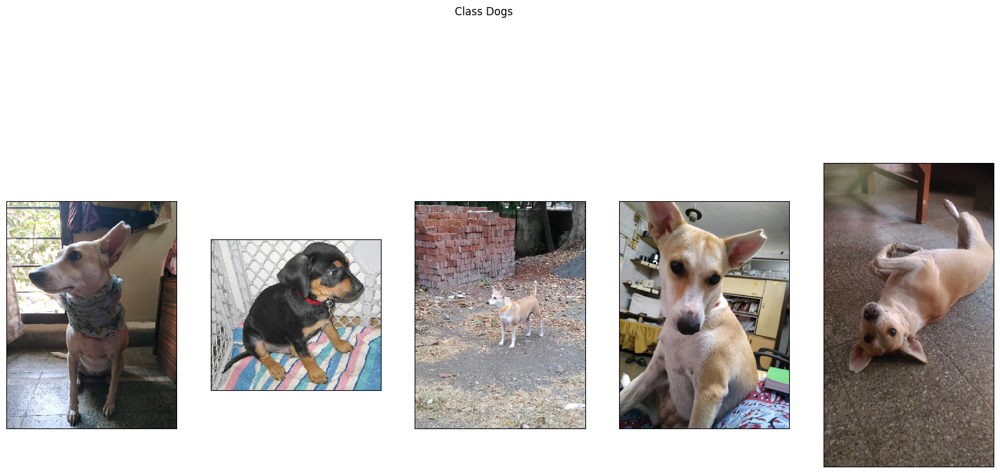

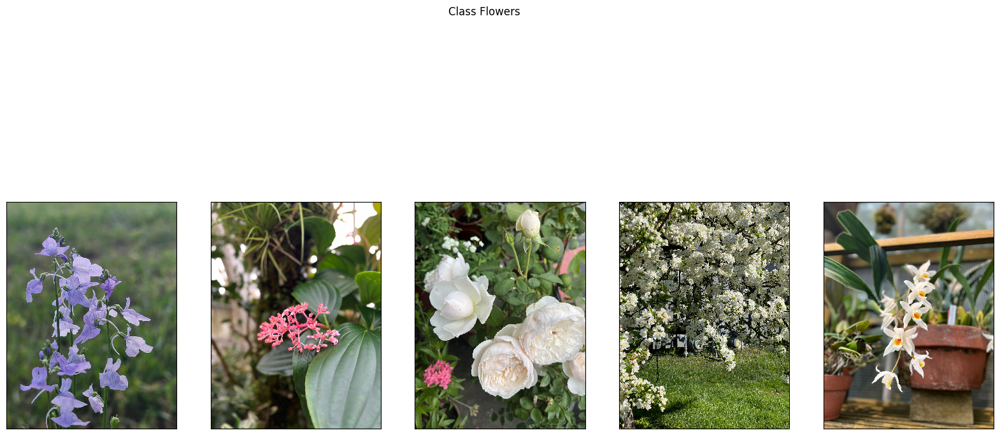

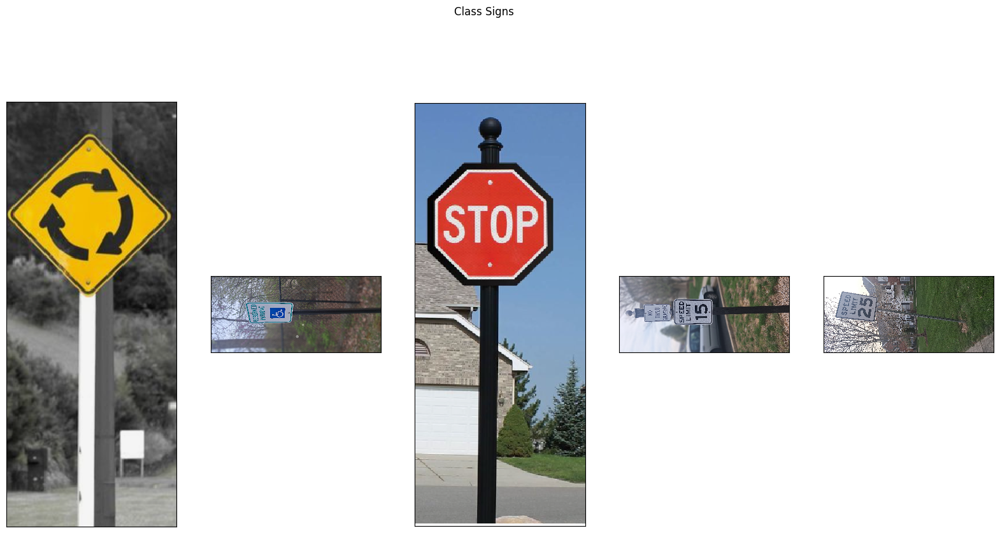

In [ ]:
for names in class_names:
  # print(f"For class name: {names}")
  curr_dir = "/content/drive/MyDrive/AML_HW4_DATA/train/"+names
  images = random.sample(os.listdir(curr_dir)[-10:],5)

  fig,axs = plt.subplots(1,5,figsize=(20,10))
  axs = axs.flatten()

  for i in range(5):
    img_arr = plt.imread(f"/content/drive/MyDrive/AML_HW4_DATA/train/{names}/{images[i]}")
    axs[i].imshow(img_arr,interpolation="nearest")
    # plt.tight_layout()
    axs[i].grid(False)  # turn off the grid
    axs[i].set_xticks([])  # turn off x-axis ticks
    axs[i].set_yticks([])  # turn off y-axis ticks
  fig.suptitle(f"Class {names.capitalize()}")

## DATA AUGMENTATION AS PART OF THE INPUT PIPELINE
* We used random flips, rotations, contrast and brightness to augment our dataset and make our model more robust to data shifts

In [ ]:
from tensorflow.keras import layers

data_augmentation = tf.keras.Sequential([
  layers.Resizing(image_size[0],image_size[1]),
  # layers.Rescaling(1./255),
  layers.RandomFlip('horizontal_and_vertical'),
  layers.RandomRotation(0.2),
  layers.RandomContrast(0.5),
  layers.RandomBrightness(0.5)
])

## SHOWING EXAMPLES OF DATA AUGMENTATION

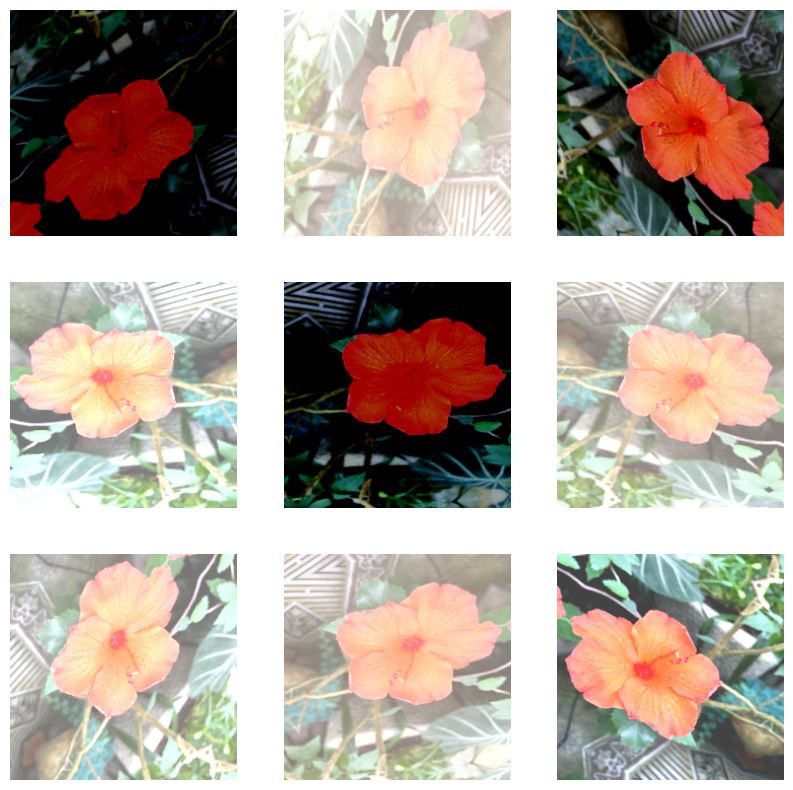

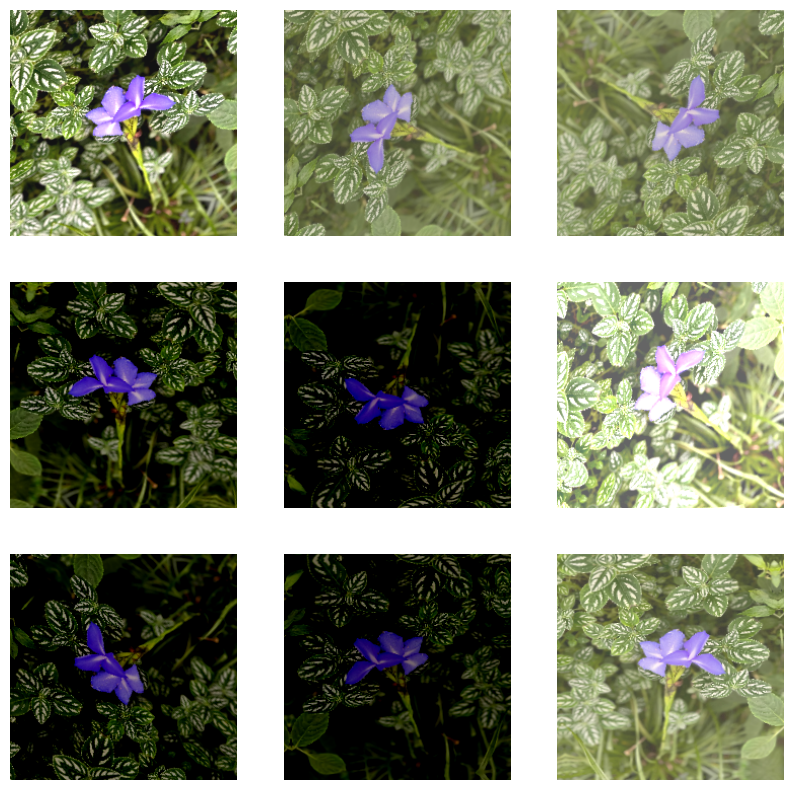

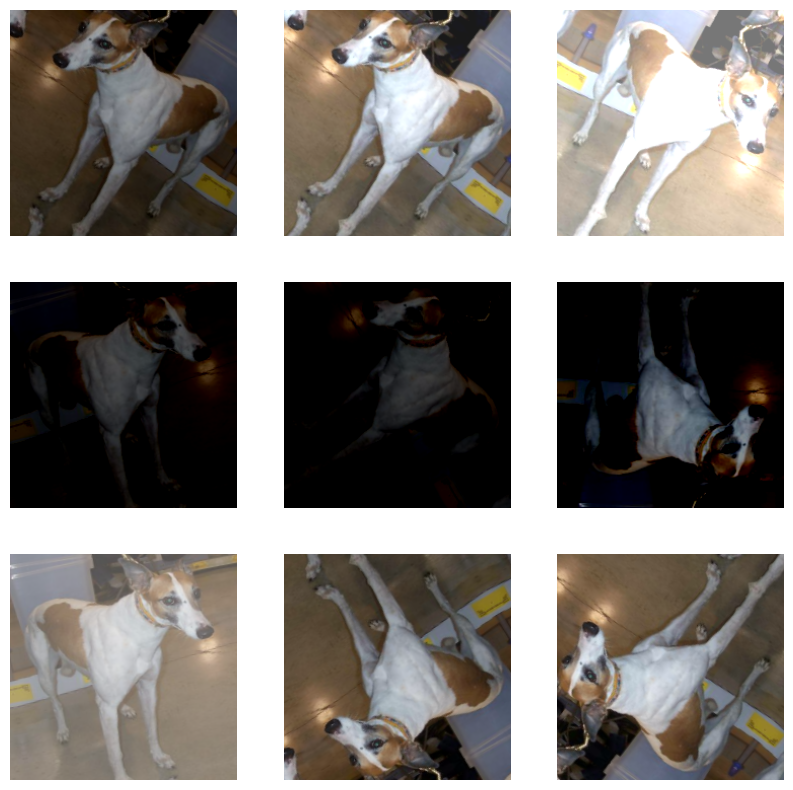

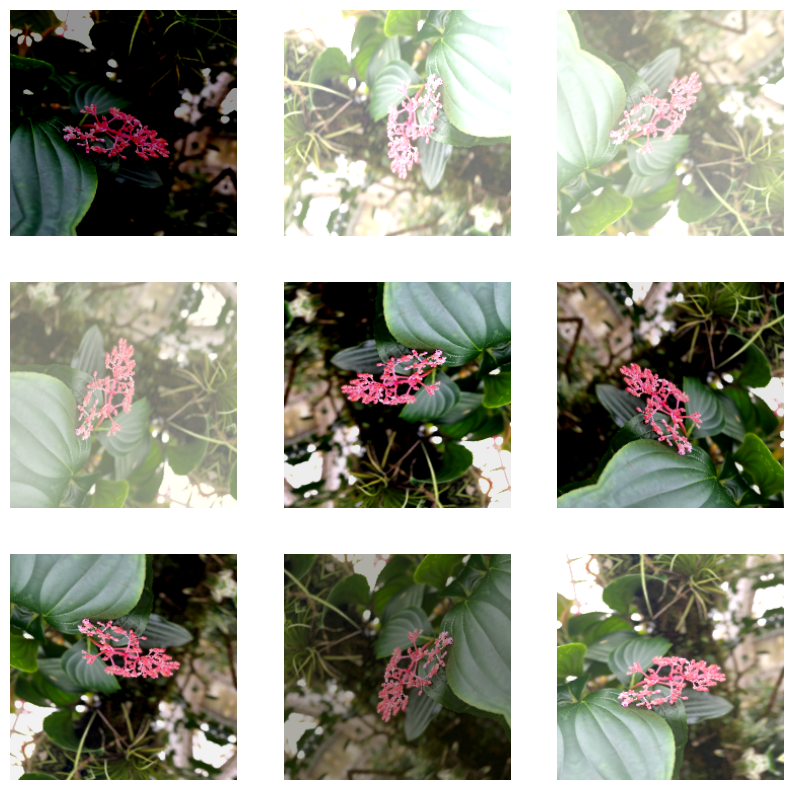

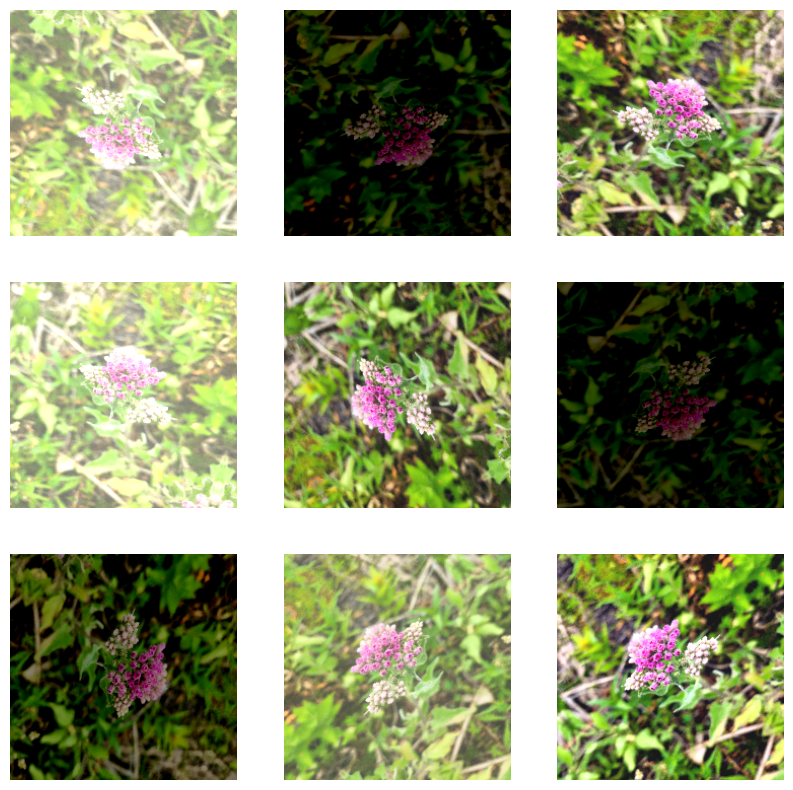

In [ ]:
for image, _ in train_dataset.take(5):
  # print(image.shape)
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0]/255)
    plt.axis('off')

(8, 224, 224, 3)


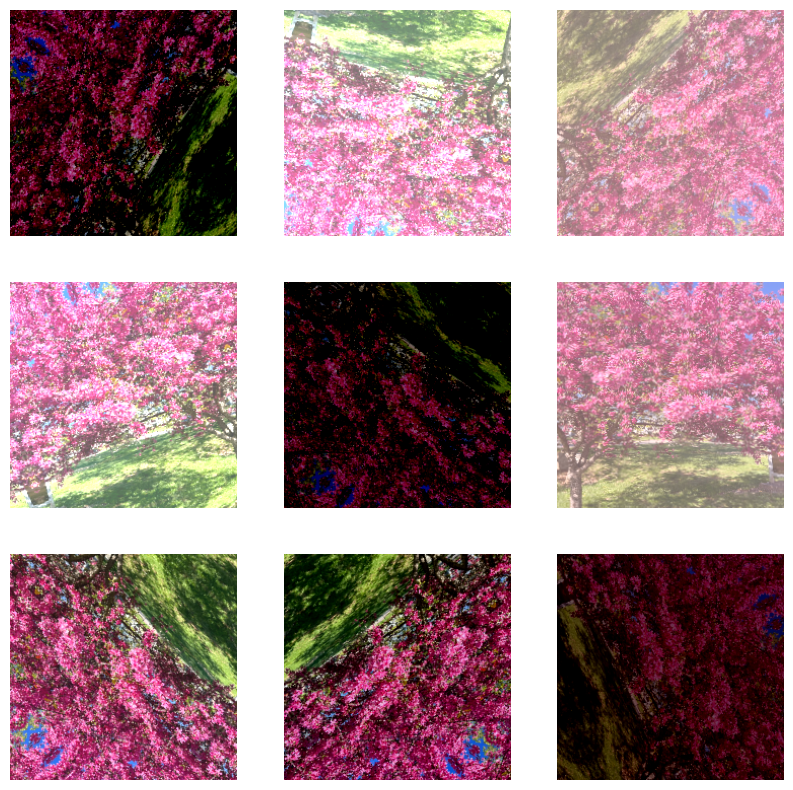

In [ ]:
for image, _ in val_dataset.take(1):
  print(image.shape)
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0]/255)
    plt.axis('off')

### **1 c. Building the input pipeline,preprocessing the images , and performing data agumentation.**

### Performing Data augmentation on train,validation and test data.

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_data_augmentation = ImageDataGenerator(
    rescale=1./255, 
    rotation_range=30, 
    width_shift_range=0.2, 
    height_shift_range=0.2, 
    shear_range=0.2, 
    zoom_range=0.2, 
    horizontal_flip=True, 
    vertical_flip=True, 
    fill_mode='nearest' 
)

val_data_augmentation = ImageDataGenerator(
    rescale=1./255
)

test_data_augmentation = ImageDataGenerator(
    rescale=1./255
)

### Loading the images from the path 

In [ ]:
train_data_generator = train_data_augmentation.flow_from_directory(
    train_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical' 
)

val_data_generator = val_data_augmentation.flow_from_directory(
    val_dir,
    target_size=image_size,
    batch_size=batch_size,
    class_mode='categorical' 
)
test_data_generator = test_data_augmentation.flow_from_directory(
    test_dir,
    target_size=image_size,
    batch_size=1,
    class_mode='categorical' 
)

Found 210 images belonging to 3 classes.
Found 30 images belonging to 3 classes.
Found 60 images belonging to 3 classes.


In [ ]:
base_model = tf.keras.applications.ResNet152V2(input_shape=(224,224,3),include_top=False,weights="imagenet")

234545216/234545216 [==============================] - 2s 0us/step


## SETTING THE LAYERS IN THE PRETRAINED TO NOT TRAINABLE

In [ ]:
for layer in base_model.layers:
    layer.trainable = False

### Preprocessing the input

In [ ]:
preprocess_input_pipeline = tf.keras.applications.resnet_v2.preprocess_input

## INPUT PIPELINE WITH DATA AUGMENTATION, PREPROCESSING FROM RESNET_V2

In [ ]:
image_inputs = tf.keras.Input(shape=(224,224,3))
# x = data_augmentation(image_inputs)
x = preprocess_input_pipeline(image_inputs)
x = base_model(x,training=False)
x = tf.keras.layers.Flatten()(base_model.output)
x = tf.keras.layers.Dense(256, activation='relu')(x)
#Adding a dropout layer
# x = tf.keras.layers.Dropout(0.2)(x)
outputs = tf.keras.layers.Dense(len(class_names),activation="softmax")(x)

model = tf.keras.Model(base_model.input,outputs)

In [ ]:
learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(
    learning_rate=learning_rate),
    loss = tf.keras.losses.CategoricalCrossentropy(),
    metrics = ["accuracy"]
)

### **1 d. Training with the  ResNetV2 Residual Network model**.

In [ ]:
num_epochs = 20
early_stopping_callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, mode='min', verbose=1,
    restore_best_weights=True,start_from_epoch=3
)
history = model.fit(
    train_data_generator,epochs=num_epochs,
    validation_data=val_data_generator,
    callbacks = [early_stopping_callback]
)

Epoch 1/20
27/27 [==============================] - 52s 2s/step - loss: 0.5635 - accuracy: 0.9000 - val_loss: 1.6916e-04 - val_accuracy: 1.0000
Epoch 2/20
27/27 [==============================] - 16s 592ms/step - loss: 0.0860 - accuracy: 0.9810 - val_loss: 0.0344 - val_accuracy: 0.9667
Epoch 3/20
27/27 [==============================] - 16s 580ms/step - loss: 0.2180 - accuracy: 0.9905 - val_loss: 5.7917e-05 - val_accuracy: 1.0000
Epoch 4/20
27/27 [==============================] - 21s 770ms/step - loss: 0.1532 - accuracy: 0.9905 - val_loss: 5.0719e-04 - val_accuracy: 1.0000
Epoch 5/20
27/27 [==============================] - 17s 609ms/step - loss: 0.0201 - accuracy: 0.9905 - val_loss: 3.6119e-06 - val_accuracy: 1.0000
Epoch 6/20
27/27 [==============================] - 17s 592ms/step - loss: 0.0249 - accuracy: 0.9952 - val_loss: 3.0200e-07 - val_accuracy: 1.0000
Epoch 7/20
27/27 [==============================] - 17s 625ms/step - loss: 0.1915 - accuracy: 0.9762 - val_loss: 4.7860e-04 -

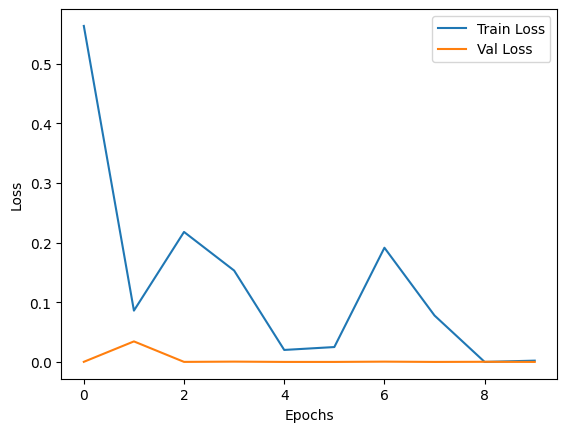

In [ ]:
plt.plot(history.history['loss'],label="Train Loss")
plt.plot(history.history['val_loss'],label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()

### **The traning loss was high initially and gradually decreased with increase in epochs, the validation loss which was low at the start incresed  and again decreased with increase in the epochs. Both validationa and training loss became CLOSE  TO 0 with increase in epochs WITH THE VALUES `loss: 0.0021 - accuracy: 1.0000 - val_loss: 5.5631e-08 - val_accuracy: 1.0000`**

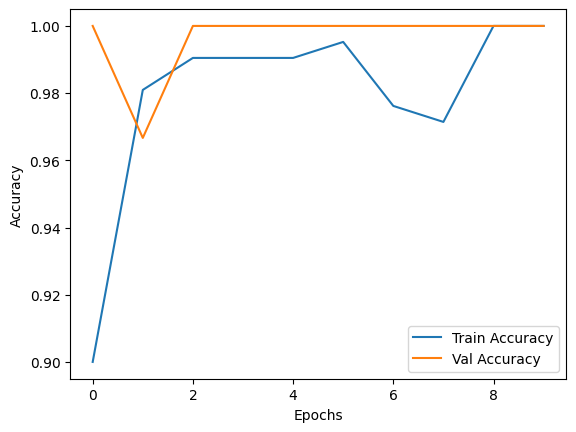

In [ ]:
plt.plot(history.history['accuracy'],label="Train Accuracy")
plt.plot(history.history['val_accuracy'],label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()

### **The Training and the Validation accuracy increased with increase in the number of epochs, the accuarcy increased and reached to 1.There is 100% accuracy and model classifed all the images correctly.**

In [ ]:
test_loss,test_acc = model.evaluate(test_data_generator)
print(f"The test loss is {test_loss} and accuracy is {test_acc}")

60/60 [==============================] - 16s 245ms/step - loss: 1.9868e-09 - accuracy: 1.0000
The test loss is 1.9868213740892315e-09 and accuracy is 1.0


In [ ]:
model.save('/content/drive/MyDrive/AML_HW4_DATA/v1.h5')

In [ ]:
len(test_data_generator)

60

In [ ]:
%%capture
from tqdm import tqdm
correct_pred = []
incorrect_pred = []
for idx,i in enumerate(test_data_generator):
  if idx == 60:break
  model_pred = np.argmax(model.predict(i[0]))
  true_class = np.argmax(i[1])
  # print(model_pred,np.argmax(true_class))

  if model_pred == true_class:
    correct_pred.append([i[0],true_class])
  else:
    incorrect_pred.append([i[0],true_class,model_pred])

## **1d.CORRECT CLASSIFICATION**
## Below are the correcly classified images with pretrained model .

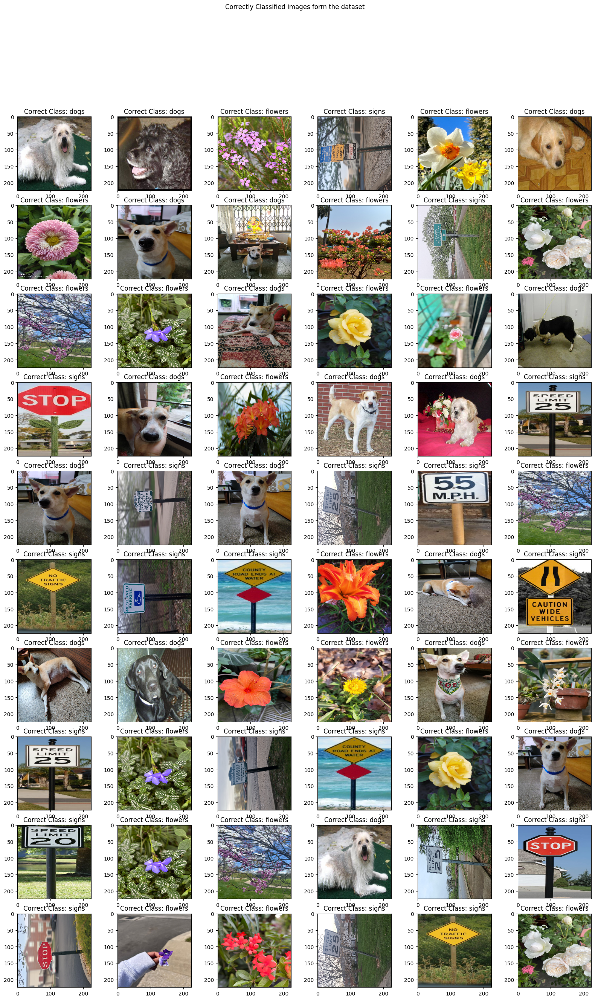

In [ ]:
nrows = 10
ncols = 6

# Create the subplots
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 30))

for idx, ax in enumerate(axes.flatten()):
  if idx==len(correct_pred):break
  img = correct_pred[idx][0][0]
  correct_label = correct_pred[idx][1]

  ax.imshow(tf.keras.preprocessing.image.array_to_img(img))
  ax.set_title(f"Correct Class: {class_names[correct_label]}")

fig.suptitle('Correctly Classified images form the dataset')
plt.show()

### **1d.INCORRECTLY CLASSIFIED : There are no incorrectly classified images with the pretrained model, all the model classified all the imgages correctly.**

In [ ]:
# nrows = 0
# ncols = 0

# # Create the subplots
# fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 8))

# for idx, ax in enumerate(axes.flatten()):
#   if idx==len(incorrect_pred)-1:break
#   img = incorrect_pred[idx][0][0]
#   correct_label = incorrect_pred[idx][1]
#   pred_label = incorrect_pred[idx][2]
#   # print(pred_label)
#   ax.imshow(tf.keras.preprocessing.image.array_to_img(img))
#   ax.set_title(f"Model Pred: {class_names[pred_label]}")

# fig.suptitle('Incorrectly Classified images form the dataset')
# plt.show()

### **1e .BUILDING FROM SCRATCH**

In [ ]:
tf.keras.backend.clear_session()

### Buliding the modle using the Relu activation function.

In [ ]:
scratch_model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16,(3,3),activation="relu",input_shape=(224,224,3),padding="same"),
    tf.keras.layers.MaxPool2D((2,2)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(32,(3,3),activation='relu',padding="same"),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D((2,2)),
    tf.keras.layers.Conv2D(64,(3,3),activation='relu',padding="same"),
    tf.keras.layers.Dropout(0.4),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256,activation='relu'),
    tf.keras.layers.Dense(len(class_names),activation='softmax')
])

In [ ]:
image_size = (224,224)
image_inputs = tf.keras.Input(shape=image_size + (3,))
print(image_inputs.shape)
x = data_augmentation(image_inputs)
outputs = scratch_model(x)


scratch_model = tf.keras.Model(image_inputs,outputs)

(None, 224, 224, 3)


In [ ]:
learning_rate = 0.0005

scratch_model.compile(optimizer=tf.keras.optimizers.Adam(
    learning_rate=learning_rate),
    loss = tf.keras.losses.SparseCategoricalCrossentropy(),
    metrics = ["accuracy"]
)

In [ ]:
scratch_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential (Sequential)     (None, 224, 224, 3)       0         
                                                                 
 sequential_1 (Sequential)   (None, 3)                 51405027  
                                                                 
Total params: 51,405,027
Trainable params: 51,404,931
Non-trainable params: 96
_________________________________________________________________


In [ ]:
num_epochs = 10

early_stopping_callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=3, mode='min', verbose=1,
    restore_best_weights=True,start_from_epoch=5
)

scratch_history = scratch_model.fit(
    train_dataset,epochs=num_epochs,
    validation_data=val_dataset,
    callbacks=[early_stopping_callback]
)

Epoch 1/10
27/27 [==============================] - 80s 2s/step - loss: 19.2997 - accuracy: 0.4000 - val_loss: 4.7803 - val_accuracy: 0.3548
Epoch 2/10
27/27 [==============================] - 26s 924ms/step - loss: 2.0645 - accuracy: 0.4667 - val_loss: 2.8084 - val_accuracy: 0.3226
Epoch 3/10
27/27 [==============================] - 26s 928ms/step - loss: 1.3724 - accuracy: 0.5571 - val_loss: 2.0378 - val_accuracy: 0.3871
Epoch 4/10
27/27 [==============================] - 25s 902ms/step - loss: 1.0473 - accuracy: 0.6333 - val_loss: 2.3469 - val_accuracy: 0.3871
Epoch 5/10
27/27 [==============================] - 26s 938ms/step - loss: 0.8594 - accuracy: 0.6571 - val_loss: 1.5320 - val_accuracy: 0.4839
Epoch 6/10
27/27 [==============================] - 27s 971ms/step - loss: 1.0393 - accuracy: 0.5857 - val_loss: 2.0622 - val_accuracy: 0.4516
Epoch 7/10
27/27 [==============================] - 27s 951ms/step - loss: 0.8192 - accuracy: 0.6619 - val_loss: 2.2778 - val_accuracy: 0.4516
E

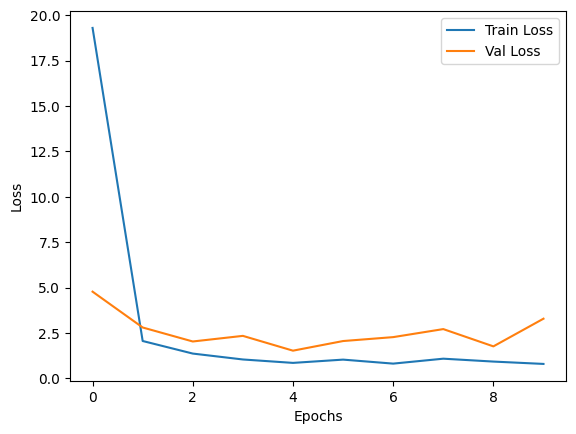

In [ ]:
plt.plot(scratch_history.history['loss'],label="Train Loss")
plt.plot(scratch_history.history['val_loss'],label="Val Loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
# plt.ylim(0,2)
plt.legend()

### **There is loss is high initially and the decreaed with increase in the epochs, the validation loss gradually decreased and again slighly increased with change in training iterations. `loss: 0.8025 - accuracy: 0.6619 - val_loss: 3.2925 - val_accuracy: 0.3871`**

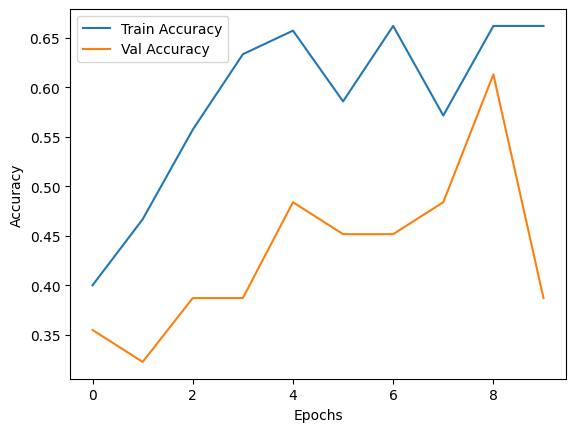

In [ ]:
plt.plot(scratch_history.history['accuracy'],label="Train Accuracy")
plt.plot(scratch_history.history['val_accuracy'],label="Val Accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.legend()

### **There are lot of fluctuations in the training and validation curves, however they both followed a increase trend with increse in the training epochs. The validation accuracy of the model increased gradually and had a sudden decrease. Early stopping prevents the validation accuracy to fall and stops training early to avoid overfitting**

In [ ]:
test_loss,test_acc = scratch_model.evaluate(test_dataset)
print(f"The test loss is {test_loss} and accuracy is {test_acc}")

60/60 [==============================] - 25s 409ms/step - loss: 3.2676 - accuracy: 0.4500
The test loss is 3.267648458480835 and accuracy is 0.44999998807907104


### **The model achived a test accuracy of 44%**

In [ ]:
%%capture
correct_pred = []
incorrect_pred = []
for i in test_dataset:
  model_pred = np.argmax(scratch_model.predict(i[0]))
  true_class = i[1]

  if model_pred == true_class:
    correct_pred.append([i[0],true_class])
  else:
    incorrect_pred.append([i[0],true_class,model_pred])

## CORRECTLY CLASSIFIED IMAGES

In [ ]:
len(correct_pred)

27

## INCORRECTLY CLASSIFIED IMAGES

In [ ]:
len(incorrect_pred)

33

### **1e.Correctly classified images without a pretrained model**

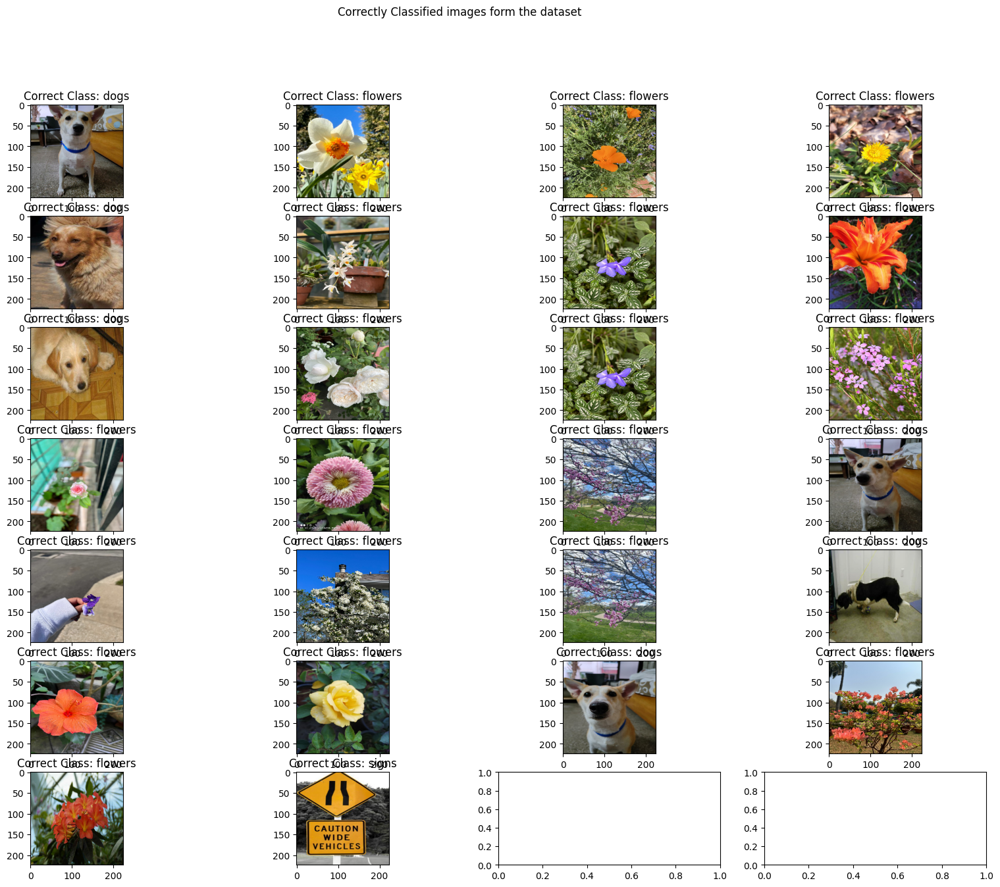

In [ ]:
nrows = 7
ncols = 4

# Create the subplots
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 15))

for idx, ax in enumerate(axes.flatten()):
  if idx==len(correct_pred)-1:break
  img = correct_pred[idx][0][0]
  correct_label = correct_pred[idx][1]

  ax.imshow(tf.keras.preprocessing.image.array_to_img(img))
  ax.set_title(f"Correct Class: {class_names[correct_label[0]]}")

fig.suptitle('Correctly Classified images form the dataset')
plt.show()

### **1e.Incorrectly classified images without a pretrained model.**

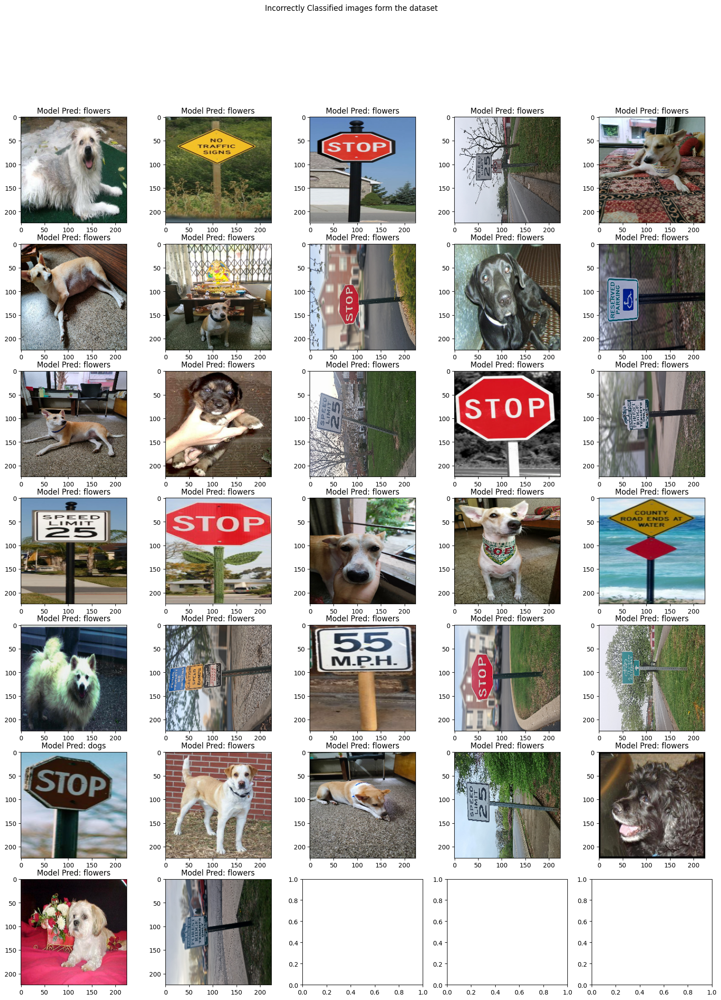

In [ ]:
nrows = 7
ncols = 5

# Create the subplots
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 25))

for idx, ax in enumerate(axes.flatten()):
  if idx==len(incorrect_pred)-1:break
  img = incorrect_pred[idx][0][0]
  correct_label = incorrect_pred[idx][1]
  pred_label = incorrect_pred[idx][2]
  # print(pred_label)
  ax.imshow(tf.keras.preprocessing.image.array_to_img(img))
  ax.set_title(f"Model Pred: {class_names[pred_label]}")

fig.suptitle('Incorrectly Classified images form the dataset')
plt.show()

## SUMMARY
1. From pretrained model to scratch model, our validation accuracy fell from `100%` to `38.71%`, test accuracy from `100%` to `45%`. Our train loss, validation loss and testing loss also increased from our pretrained model to scratch model